**Siguientes pasos:**

- Redactar memoria primera vuelta, algoritmo genético, shap, error obtenido, etc
- Análisis de error obtenido
- Interpretación del modelo
- API


**Preguntar a Raúl**
- Azure function: No consigo que funcione. No sé si merece la pena, porque tiene que estar el programa abierto para que funcione. Y es muy cutre a fin de cuentas.
- Estructura de la memoria desarrollo-resultados es correcta?
- Cómo entrego el código del algoritmo genético? Subo también el Salga? Lo rehago con una librería de python?
- He explicado de más en la memoria?
- Tengo que referenciar cada definición que haga, en qué paginas web me he basado? O en los articulo originales de cada modelo por ejemplo?
- Tengo imágenes que ocupan más de una carilla, cómo las pongo?
- 

Podría ser interesante enfocar la memoria como un flujo completo de un proyecto de Data Science: 
  - Objetivo
  - Obtención de los datos
  - Limpieza de datos
  - Análisis de datos
  - Refinar los datos
  - Creación de modelos
  - Validación de modelos(Conjunto de test)
  - Evaluar los modelos(Análisis de resultados)
  - (Interfaz de despliegue)
  - Conclusiones
  - Referencia(Barton Poulson Professor, Designer, Data Analytics Expert - Curso LinkedIn)

**Planificación Calendario**
* 27/03 - 18/04 (3 Semanas) -> Análisis y preprocesamiento
* 18/04 - 23/05 (5 Semanas) -> Modelos
* 23/05 - 13/06 (3 Semanas) -> Análisis de resultados
* 13/06 - 20/06 (1 Semana) -> Finiquitar memoria
* 20/06 ENTREGA DEL TFG
* 20/06 - 30/06 (1-2 semanas) -> Preparar presentación
* 30/06 PRESENTACIÓN TFG

# Importar Liberías

In [1]:
import pandas as pd
import numpy as np
import sklearn 
pd.set_option("display.max_columns", None)
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
import ast
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import models
from tensorflow.keras import backend as K
import requests
from matplotlib.pyplot import xticks
import pickle
import shap
shap.initjs()

# Importar dataset

In [2]:
df = pd.read_csv('Data/Datasets/PreprocessedDataset.csv', sep=',')

In [3]:
df

,Year,Female,Male,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
0,-1.676227,1,1,-1.811064,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.654428,-0.106513,-1.799759,0.948818,0.838319,0.783940,0.872131,-0.076141,1.102993,-1.684581,0.487389,0.040946,0.569680,-0.009104,-0.304262,0.055954,-1.087623,-1.193874,-1.222978,-1.024286,-1.609031,-1.350799,-1.469300,-1.104711,-0.062266,1.023815,-0.248500,-1.229130,-0.733760,-1.177121,-1.188014,1.685753,0.681710,-1.233231,0.994439,0.876812,0.870163,-1.095904,-1.197077,1.021791,0.159759,0.230526,-1.332338,-1.911954,-0.991231,-1.87640,-1.034323,-0.569039,-0.330174,-1.003075,-1.096987,-0.656821,1.639689,-0.679713,-0.937830,0.129569,-1.813564,-0.718468,0.509331,-1.163691,-0.613941,-0.549370,1.407984,-1.019481,-1.318237,-0.922712,-0.728863,1.733196,1.671335,0.657377,1.470044,0.182323,-0.727586,0.815761,-0.856345,-0.319981,0.978972,1.961721,3.813995
1,-1.676227,1,0,-1.700317,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.654428,-0.106513,-1.799759,0.948818,0.838319,0.783940,0.872131,-0.076141,1.102993,-1.684581,0.487389,0.040946,0.569680,-0.009104,-0.304262,0.055954,-1.087623,-1.193874,-1.222978,-1.024286,-1.609031,-1.350799,-1.469300,-1.104711,-0.062266,1.023815,-0.248500,-1.229130,-0.733760,-1.177121,-1.188014,1.685753,0.681710,-1.233231,0.994438,0.876811,0.870163,-1.095904,-1.197077,1.021791,0.159759,0.230526,-1.332338,-1.911954,-0.991231,-1.87640,-1.034323,-0.569039,-0.330174,-1.003075,-1.096987,-0.656821,1.639689,-0.679713,-0.937830,0.129569,-1.813564,-0.718468,0.509331,-1.163691,-0.613941,-0.549369,1.407984,-1.019481,-1.318237,-0.922712,-0.728863,1.733196,1.671335,0.657377,1.470044,0.182323,-0.727586,0.815761,-0.856345,-0.319981,0.978972,1.961721,3.813995
2,-1.676227,0,1,-1.915730,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.6

# Separación de la variable objetivo

In [4]:
X = df.drop(columns=['Life Expectancy'])
y = df['Life Expectancy']

# División en conjunto de entrenamiento y de test

In [5]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=21)

# Funciones

In [6]:
# Importamos el dataset con los datos preprocesados pero sin estandarizar
df_filled = pd.read_csv('Data/Datasets/FilledDataset.csv',sep=',')

In [7]:
# Cargamos los scalers para hacer y deshacer las transformaciones
scalerLE = pickle.load(open('Data/Scalers/LE_Scaler.pkl', 'rb'))
scaler_total = pickle.load(open('Data/Scalers/Normal_Features_Scaler.pkl', 'rb'))
power_YJ = pickle.load(open('Data/Scalers/Yeo-Johnson_Scaler.pkl', 'rb'))

In [8]:
#Desestandarizamos la variable objetivo del conjunto de test
y_test_unstandarized = scalerLE.inverse_transform(y_test.values.reshape(-1,1)).flatten()

In [9]:
#Error de entrenamiento y de test según diferentes métricas de medida:
def errorMetrics(y_train_predicted,y_test_predicted):
    y_test_predicted_unstandarized = scalerLE.inverse_transform(y_test_predicted)

    print("\nRMSE Train standarized values: ", str(mean_squared_error(y_train, y_train_predicted, squared = False)))
    print("RMSE Test standarized values: ", str(mean_squared_error(y_test, y_test_predicted, squared = False)))
    print("RMSE Test absolute values: ", str(mean_squared_error(y_test_unstandarized, y_test_predicted_unstandarized, squared = False)))

    print("\nMAE Train standarized values: ", str(mean_absolute_error(y_train, y_train_predicted)))
    print("MAE Test standarized values: ", str(mean_absolute_error(y_test, y_test_predicted)))
    print("MAE Test absolute values: ", str(mean_absolute_error(y_test_unstandarized, y_test_predicted_unstandarized)))

    print("\nR2 Train: ", str(r2_score(y_train, y_train_predicted)))
    print("R2 Test: ", str(r2_score(y_test, y_test_predicted)))

In [10]:
# Función para poder calcular el error R2 al entrenar la red de neuronas
def r2_score_metric(y_true, y_pred):
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )
#Cortesía de https://jmlb.github.io/ml/2017/03/20/CoeffDetermination_CustomMetric4Keras/

In [11]:
#Función para desestandarizar el error y obtenerlo en años de vida
def errorsUnstandarized(y_test_predicted):
    y_test_predicted_unstandarized = scalerLE.inverse_transform(y_test_predicted)
    rmse = mean_squared_error(y_test_unstandarized, y_test_predicted_unstandarized, squared = False)
    mae = mean_absolute_error(y_test_unstandarized, y_test_predicted_unstandarized)
    r2 = r2_score(y_test, y_test_predicted)
    return {'RMSE': rmse, 'MAE': mae, 'R2': r2}

In [12]:
#Importar Red de Neuronas
NN_model = tf.keras.models.load_model('Data/Models/NN_Model.h5', compile=False)
NN_model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])

# Modelos

## Regresión Lineal

In [13]:
#Entrenamiento
linear = LinearRegression()
linear.fit(X_train, y_train) 

LinearRegression()

In [14]:
print("Regresión Lineal:")
errorMetrics(linear.predict(X_train), linear.predict(X_test))

Regresión Lineal:

RMSE Train standarized values:  0.27293409601150037
RMSE Test standarized values:  0.28089863651790054
RMSE Test absolute values:  2.817950427409114

MAE Train standarized values:  0.19901675054359796
MAE Test standarized values:  0.20302305433329965
MAE Test absolute values:  2.0367094330697024

R2 Train:  0.9247785165850644
R2 Test:  0.9240373819236388


In [15]:
pd.DataFrame({'Feature': X.columns, 'Coef. Reg. Lineal': linear.coef_, 'Abs Coef': abs(linear.coef_), }).sort_values(by='Abs Coef', ascending=False).reset_index(drop=True)[['Feature', 'Coef. Reg. Lineal']].head(10)

,Feature,Coef. Reg. Lineal
0,% Death Cardiovascular,-0.564364
1,% Population $3.20 a day,-0.469647
2,% Population $5.50 a day,0.288774
3,Diet Calories Fat,-0.278334
4,Low CI Value % Death Cardiovascular,0.278073
5,Male,-0.235947
6,Female,0.227142
7,Basic Sanization Services Urban,0.210566
8,Year,0.202589
9,Low CI Value Incidence of Tuberculosis,-0.199887


In [15]:
#Guardar modelo de regresión lineal
pickle.dump(linear, open('Data/Models/LinearRegression.sav', 'wb'))

In [14]:
# Cargar modelo
linear = pickle.load(open('Data/Models/LinearRegression.sav', 'rb'))

## Elastic-Net

In [13]:
#GridSearch de la regresión Elastic-Net

grid_EN = GridSearchCV(
    ElasticNet(),
    {'alpha': (0,0.00001,0.0001,0.001,0.1,1,10,100,1000),
    'l1_ratio': (0,0.001, 0.01, 0.1, 0.5,0.9,0.99,0.999,1)},
    scoring='neg_root_mean_squared_error',                                 
    cv=5,
    n_jobs=-1,
    verbose = 0,
    return_train_score = True
)

grid_EN.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': (0, 1e-05, 0.0001, 0.001, 0.1, 1, 10, 100,
                                   1000),
                         'l1_ratio': (0, 0.001, 0.01, 0.1, 0.5, 0.9, 0.99,
                                      0.999, 1)},
             return_train_score=True, scoring='neg_root_mean_squared_error')

In [14]:
resultados = pd.DataFrame(grid_EN.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False) 

,param_alpha,param_l1_ratio,mean_test_score,std_test_score,mean_train_score,std_train_score
0,0,0,-0.274716,0.010351,-0.272724,0.002579
1,0,0.001,-0.274716,0.010351,-0.272724,0.002579
2,0,0.01,-0.274716,0.010351,-0.272724,0.002579
3,0,0.1,-0.274716,0.010351,-0.272724,0.002579
4,0,0.5,-0.274716,0.010351,-0.272724,0.002579
...,...,...,...,...,...,...
53,1,1,-0.995161,0.006526,-0.995141,0.001642
52,1,0.999,-0.995161,0.006526,-0.995141,0.001642
51,1,0.99,-0.995161,0.006526,-0.995141,0.001642
50,1,0.9,-0.995161,0.006526,-0.995141,0.001642


In [15]:
errorMetrics(grid_EN.predict(X_train), grid_EN.predict(X_test))


RMSE Train standarized values:  0.27295391839303124
RMSE Test standarized values:  0.28093435792190197
RMSE Test absolute values:  2.818308781393745

MAE Train standarized values:  0.19902321766075431
MAE Test standarized values:  0.20297547475707312
MAE Test absolute values:  2.0362321189437758

R2 Train:  0.92476758996863
R2 Test:  0.9240180606201395


## KNN

In [16]:
#GridSearch de la regresión KNN 
grid_KNN = GridSearchCV(
    KNeighborsRegressor(),
    {'n_neighbors': (2,3,4,5,10),
     'weights': ('uniform', 'distance')},
     scoring='neg_root_mean_squared_error',                              
     cv=5,
     n_jobs=-1,
     return_train_score = True
)
grid_KNN.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsRegressor(), n_jobs=-1,
             param_grid={'n_neighbors': (2, 3, 4, 5, 10),
                         'weights': ('uniform', 'distance')},
             return_train_score=True, scoring='neg_root_mean_squared_error')

In [17]:
resultados = pd.DataFrame(grid_KNN.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)

,param_n_neighbors,param_weights,mean_test_score,std_test_score,mean_train_score,std_train_score
5,4,distance,-0.159424,0.003600,NaN,NaN
3,3,distance,-0.160674,0.003847,-1.580493e-08,2.836588e-10
7,5,distance,-0.160811,0.003698,NaN,NaN
2,3,uniform,-0.162413,0.004091,-1.156815e-01,7.887519e-04
4,4,uniform,-0.162871,0.003707,NaN,NaN
6,5,uniform,-0.165702,0.003858,NaN,NaN
1,2,distance,-0.169439,0.003562,NaN,NaN
0,2,uniform,-0.172268,0.003450,NaN,NaN
9,10,distance,-0.174113,0.004463,NaN,NaN
8,10,uniform,-0.185672,0.004439,NaN,NaN


In [18]:
errorMetrics(grid_KNN.predict(X_train), grid_KNN.predict(X_test))


RMSE Train standarized values:  2.0150320850654984e-08
RMSE Test standarized values:  0.15365386572641682
RMSE Test absolute values:  1.5414420730704625

MAE Train standarized values:  5.541646514767205e-09
MAE Test standarized values:  0.1038395410763341
MAE Test absolute values:  1.0417091474182887

R2 Train:  0.9999999999999996
R2 Test:  0.9772706171366786


## Random Forrest Regressor

In [ ]:
rf = RandomForestRegressor(n_estimators=100, criterion='mse', max_depth=100, n_jobs=-1)
rf.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=100, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [ ]:
errorMetrics(rf.predict(X_train), rf.predict(X_test))


RMSE Train standarized values:  0.028154138576077552
RMSE Test standarized values:  0.07062329342960864
RMSE Test absolute values:  0.7084866711067952

MAE Train standarized values:  0.017202013530308157
MAE Test standarized values:  0.04537513387295614
MAE Test absolute values:  0.4551993540306637

R2 Train:  0.9991995931516742
R2 Test:  0.9951982826157288


Se ha probado con más árboles y no mejora

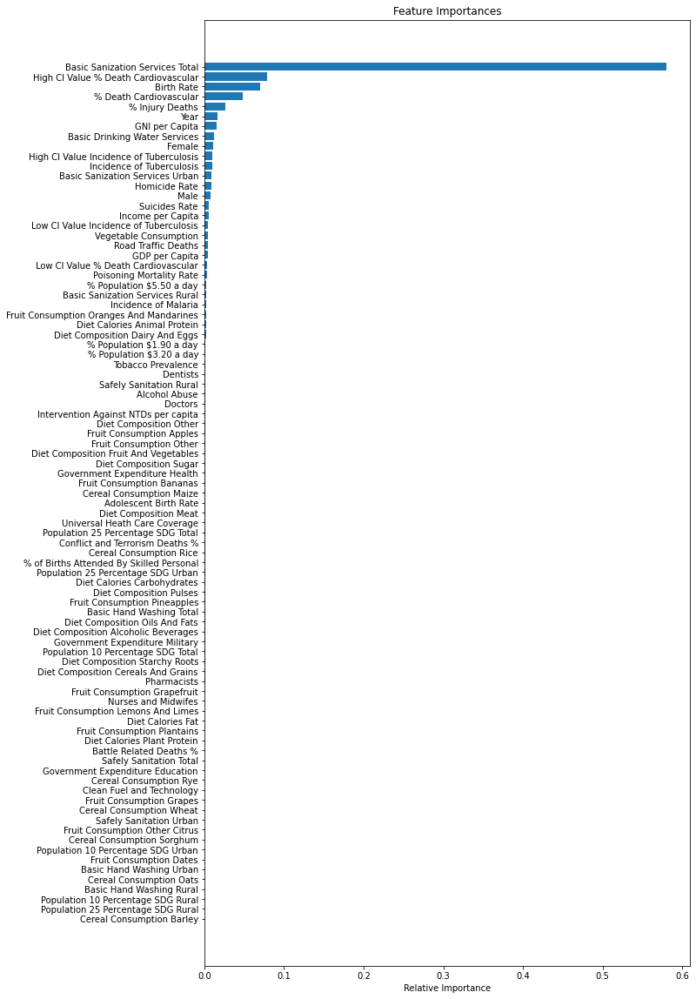

In [ ]:
# plotting feature importances
features = X.columns
importances = rf.feature_importances_
indices = np.argsort(importances)
plt.figure(figsize=(10,20))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
orderedFeaturesRF = orderedFeatures[::-1]

## Red de Neuronas

In [21]:
NN_model = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(len(X_train.keys()),)),
                          layers.Dense(350, activation=tf.nn.relu),
                          layers.Dense(1)]) #Activación linear
                         
# optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)

NN_model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', r2_score_metric])

In [22]:
NN_model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 350)               30800     
_________________________________________________________________
dense_5 (Dense)              (None, 350)               122850    
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 351       
Total params: 154,001
Trainable params: 154,001
Non-trainable params: 0
_________________________________________________________________


In [23]:
class PrintEpochMetrics(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if (epoch%20 == 0):
            print(logs)

In [ ]:
#Early stop: Para cuando el valor de validación empieza a empeorar respectp al de entrenamiento
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=30)

hist = NN_model.fit(X_train, y_train, epochs=1000, verbose=0, validation_split=0.3, callbacks=[early_stop, PrintEpochMetrics()])

{'loss': 0.13501733541488647, 'mae': 0.2518026530742645, 'mse': 0.13501733541488647, 'r2_score_metric': 0.8595440983772278, 'val_loss': 0.05408341810107231, 'val_mae': 0.1688615083694458, 'val_mse': 0.05408341810107231, 'val_r2_score_metric': 0.9412819743156433}
{'loss': 0.0026390133425593376, 'mae': 0.0377783440053463, 'mse': 0.0026390133425593376, 'r2_score_metric': 0.997202455997467, 'val_loss': 0.0052178045734763145, 'val_mae': 0.050376635044813156, 'val_mse': 0.0052178045734763145, 'val_r2_score_metric': 0.9941689968109131}
{'loss': 0.0009555236320011318, 'mae': 0.023001713678240776, 'mse': 0.0009555236320011318, 'r2_score_metric': 0.9989743232727051, 'val_loss': 0.003706514835357666, 'val_mae': 0.04129207134246826, 'val_mse': 0.003706514835357666, 'val_r2_score_metric': 0.9959049820899963}
{'loss': 0.0007666382589377463, 'mae': 0.020987924188375473, 'mse': 0.0007666382589377463, 'r2_score_metric': 0.9991560578346252, 'val_loss': 0.003095831722021103, 'val_mae': 0.0383965335786342

In [ ]:
#Guardamos el modelo
NN_model.save('Data/Models/NN_Model.h5')

In [ ]:
pd.DataFrame(hist.history)

,loss,mae,mse,r2_score_metric,val_loss,val_mae,val_mse,val_r2_score_metric
0,0.135017,0.251803,0.135017,0.859544,0.054083,0.168862,0.054083,0.941282
1,0.041083,0.144036,0.041083,0.955654,0.031154,0.126510,0.031154,0.965851
2,0.025279,0.112564,0.025279,0.973002,0.022892,0.106973,0.022892,0.974691
3,0.017990,0.095494,0.017990,0.980415,0.018893,0.097480,0.018893,0.979104
4,0.013963,0.084505,0.013963,0.984778,0.015467,0.088168,0.015467,0.982906
...,...,...,...,...,...,...,...,...
393,0.000213,0.010649,0.000213,0.999768,0.001582,0.025431,0.001582,0.998207
394,0.000209,0.010207,0.000209,0.999776,0.001738,0.026674,0.001738,0.998059
395,0.000266,0.011885,0.000266,0.999717,0.001794,0.028185,0.001794,0.997998
396,0.000190,0.010040,0.000190,0.999792,0.001605,0.026258,0.001605,0.998183


In [ ]:
def plotHistory(history):
    history = pd.DataFrame(hist.history)
    history['epoch'] = hist.epoch 

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error(RMSE)')
    plt.plot(history['epoch'], (history['mse'] ** 1/2), label='Train Error')
    plt.plot(history['epoch'], (history['val_mse'] ** 1/2), label='Validation Error')
    plt.legend()

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Mean Absolute Error(MAE)')
    plt.plot(history['epoch'], history['mae'], label='Train Error')
    plt.plot(history['epoch'], history['val_mae'], label='Validation Error')
    plt.legend()

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Coefficient of Determination R2')
    plt.plot(history['epoch'], history['r2_score_metric'], label='Train Error')
    plt.plot(history['epoch'], history['val_r2_score_metric'], label='Validation Error')
    plt.legend()

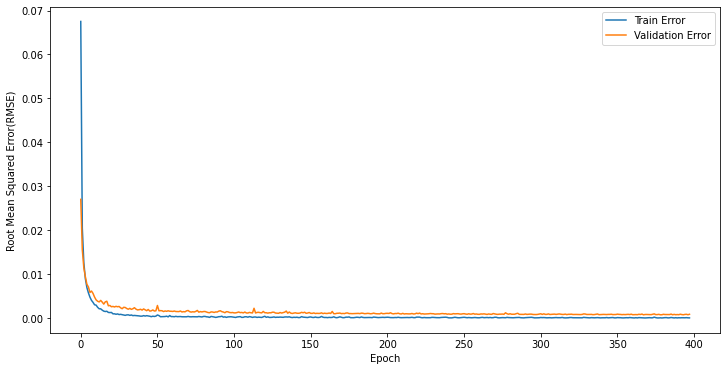

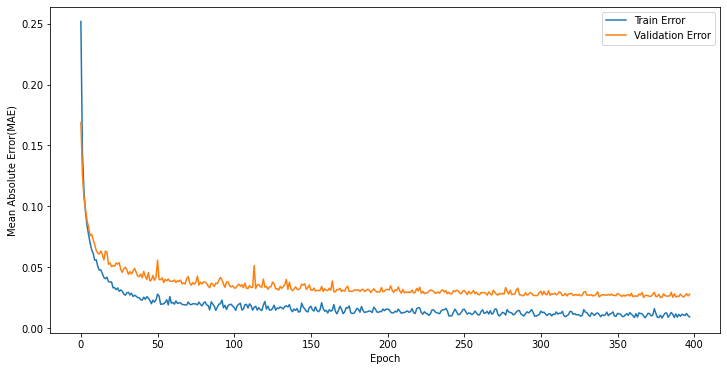

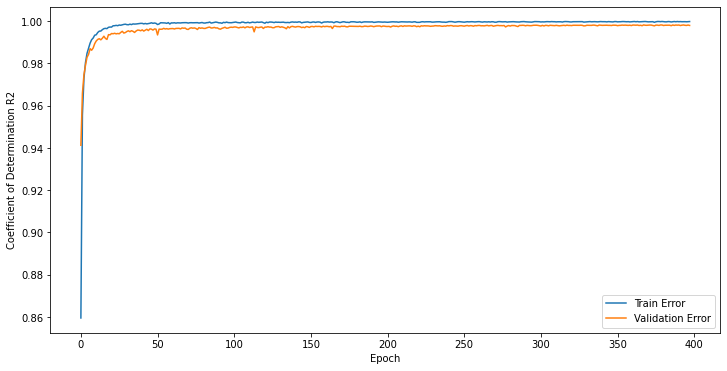

In [ ]:
plotHistory(hist)

In [ ]:
print('Red de Neuronas:')
errorMetrics(NN_model.predict(X_train).flatten(),NN_model.predict(X_test).flatten())

Red de Neuronas:

RMSE Train standarized values:  0.027674162682268386
RMSE Test standarized values:  0.04694564369527847
RMSE Test absolute values:  0.4709545372392034

MAE Train standarized values:  0.0177312895160565
MAE Test standarized values:  0.029433016272691227
MAE Test absolute values:  0.2952694045818755

R2 Train:  0.9992266514292347
R2 Test:  0.9978782644228321


# Predictor

Implementar para tres posibles alternativas:
1. Predictor con todos los indicadores introducidos a mano
2. Predictor con todos los indicadores introducidos por año, pais y género y modificados los que se deseen
3. Predictor con solo los indicadores más relevantes

In [24]:
#Creamos las listas de las features que se van a transformar
columnsYJ = list(df.columns)
columnsYJ.remove('Male')
columnsYJ.remove('Female')
columnsYJ.remove('Life Expectancy')

featuresScale = ['Life Expectancy', '% Death Cardiovascular','Tobacco Prevalence','Road Traffic Deaths','% Injury Deaths', 
            'Government Expenditure Education', 'Government Expenditure Health', 'Diet Composition Cereals And Grains', 
            'Diet Composition Fruit And Vegetables', 'Diet Composition Oils And Fats', 'Diet Calories Plant Protein', 
            'Diet Calories Carbohydrates']

In [25]:
def applyTransformations(d): 
    data = d.copy()
    data.drop(columns=['Country'], inplace=True)
    data.insert(loc=1,column='Female',value=data['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
    data.insert(loc=2,column='Male',value=data['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
    data.drop(columns=['Gender'], inplace=True)

    data[featuresScale] = scaler_total.transform(data[featuresScale])
    data[columnsYJ] = power_YJ.transform(data[columnsYJ])

    data.drop(columns=['Life Expectancy'], inplace=True)
    return data

In [26]:
def predictLifeExpectancy(data):
    #Calculamos la esperanza de vida mediante la Red de Neuronas
    life_expectancy = NN_model.predict(data)
    return scalerLE.inverse_transform(life_expectancy).flatten()[0]

In [27]:
def compareLifeExpectancy(dataOriginal, data):
    print(f"País: {dataOriginal['Country'].iloc[0]}. Año: {int (dataOriginal['Year'].iloc[0])}. Género: {dataOriginal['Gender'].iloc[0]}")
    print(f"Esperanza de vida real: {dataOriginal['Life Expectancy'].iloc[0]}")
    print(f"Esperanza de vida según el predictor: {predictLifeExpectancy(applyTransformations(dataOriginal))}")
    print(f"Esperanza de vida tras los cambios: {predictLifeExpectancy(applyTransformations(data))}")

In [28]:
def getData(country, year, gender):
    # country: Nombre del país en inglés
    # year: Rango dentro del intervalo [1990, 2019]
    # gender:Posibles valores: Male, Female y Both sexes
    data = df_filled[(df_filled['Country'] == country)&(df_filled['Year'] == year)&(df_filled['Gender'] == gender)]
    return data

In [12]:
# Obtener los datos de un país en un año y un género:
country = 'Spain' #Nombre del país en inglés
year = 1995 # Rango dentro del intervalo [1990, 2019]
gender = 'Both sexes' #Posibles valores: Male, Female y Both sexes

data = df_filled[(df_filled['Country'] == country)&(df_filled['Year'] == year)&(df_filled['Gender'] == gender)]
dataOriginal = data.copy() # Guardamos 
data

,Country,Year,Gender,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,...,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
12075,Spain,1995.0,Both sexes,78.175,11.15,9.65,12.85,7.7068,11.836352,0.2149,...,11.0,653.0,69.0,269.2,161.6,1269.36,1516.84,0.000006,0.000001,2.067952e-25


In [20]:
data = getData(country = 'Spain', year = 1995, gender = 'Both sexes')
dataOriginal = data.copy()

In [21]:
#Modificar indicadores
data['% Death Cardiovascular'] -= 1
data['Alcohol Abuse'] -= 1.0
data['Tobacco Prevalence'] -= data['Tobacco Prevalence']*0.10     # Decrementamos en un 10%

In [14]:
predictLifeExpectancy(applyTransformations(data))

78.32972

In [128]:
compareLifeExpectancy(dataOriginal, data)

País: Spain. Año: 1995. Género: Both sexes
Esperanza de vida real: 78.175
Esperanza de vida según el predictor: 78.32971954345703
Esperanza de vida tras los cambios: 78.24079132080078


# Análisis de error

In [121]:
#Predicción del conjunto de test por la red neuronal en años de vida
y_predicted_unstandarized = scalerLE.inverse_transform(NN_model.predict(X_test).flatten())

In [122]:
real_vs_predicted = X_test.copy()
real_vs_predicted['Life Expectancy'] = y_test.values
real_vs_predicted['Life Expectancy Predicted'] = NN_model.predict(X_test).flatten()
real_vs_predicted.reset_index(drop=True, inplace=True)

In [123]:
real_vs_predicted['Real Value'] = y_test_unstandarized
real_vs_predicted['Prediction'] = y_predicted_unstandarized
real_vs_predicted['Difference'] = y_predicted_unstandarized - y_test_unstandarized
real_vs_predicted['Estimation'] = real_vs_predicted['Difference'].apply(lambda x: 'Underestimation'if(x <= real_vs_predicted['Difference'].quantile(0.025))
                                                                        else('Overestimation' if(x >= real_vs_predicted['Difference'].quantile(0.975))
                                                                             else 'Middle'))

In [124]:
real_vs_predicted

,Year,Female,Male,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %,Life Expectancy,Life Expectancy Predicted,Real Value,Prediction,Difference,Estimation
0,1.212854,1,0,-0.445464,-0.258605,-0.464610,-1.666289,-1.250088,0.018492,-0.764835,-1.000138,-0.480768,-0.459467,-0.483771,-0.449934,0.156751,0.738389,-0.623546,0.437486,0.593573,0.285209,0.784914,0.752343,0.823002,-0.452473,-2.043267,0.014626,-1.365565,0.410977,-0.366720,-0.151916,-0.465960,-0.732743,0.359889,0.244158,0.228928,0.280641,0.185431,-0.457374,0.411625,1.412385,0.108216,0.486958,0.363767,0.318880,0.145247,0.049874,1.749132,1.681839,-0.660986,-0.680970,-0.633284,-0.810526,1.115582,-0.983490,-0.969448,-0.256838,-0.584107,-1.958098,1.119778,0.252327,-0.256582,0.245275,0.357613,-0.551973,-0.718468,0.888837,0.297766,-0.385090,1.821758,0.049137,-0.866103,1.387100,-0.922712,-0.728863,-1.004254,-0.435410,1.746071,-0.667563,-0.750030,-0.735848,0.353102,-0.795638,-0.134342,0.419703,-0.450413,-0.233235,0.773787,0.755834,76.262,76.081894,-0.180106,Middle
1,1.558937,1,0,-0.934257,-1.435221,-0.545281,-0.179480,-0.409661,0.255670,0.701836,-0.074694,-0.859014,0.812954,0.747427,0.855500,0.982937,-0.316109,0.590174,0.940913,0.581797,1.021324,0.926521,0.665109,0.988219,-0.357481,-0.658474,-0.791041,0.314182,0.122770,-0.249798,0.256907,-0.161262,0.103195,0.264861,-0.069892,0.639585,0.884682,0.639978,0.057256,-0.406352,0.383579,-0.164424,-0.501876,-0.427558,-0.262415,-0.146011,-0.224788,-0.851247,0.030537,0.378586,-1.018006,-0.706316,-0.613610,-1.236778,-1.613369,0.307631,-1.506805,-0.411222,-0.961648,-0.444265,1.284443,0.315785,1.250708,0.692128,0.638028,-0.718468,-0.932708,-0.274321,-0.981876,-1.290866,-0.831237,1.215535,0.954839,-0.922712,-0.728863,-1.004254,-0.676762,-0.014305,-1.663003,1.816951,-0.766333,-0.022850,-1.082018,0.051607,-0.36690

In [158]:
print('Información sobre el error:\n')

print(f"Error medio por sobreestimación en años es: {real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Difference'].mean()}")
print(f"El mayor error por sobreestimación en años es: {real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Difference'].max()}")
print(f"Cuantil 0.975 para determinar sobreestimación: {real_vs_predicted['Difference'].quantile(0.975)}")

print(f"\nError medio por infraestimación en años es: {real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Difference'].mean()}")
print(f"El mayor error por infraestimación en años es: {real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Difference'].min()}")
print(f"Cuantil 0.025 para determinar infraestimación: {real_vs_predicted['Difference'].quantile(0.025)}")

Información sobre el error:

Error medio por sobreestimación en años es: 1.276016361448499
El mayor error por sobreestimación en años es: 3.721795928955075
Cuantil 0.975 para determinar sobreestimación: 0.7938879089355428

Error medio por infraestimación en años es: -1.4538964108361148
El mayor error por infraestimación en años es: -7.314390991210942
Cuantil 0.025 para determinar infraestimación: -0.8443501708984392


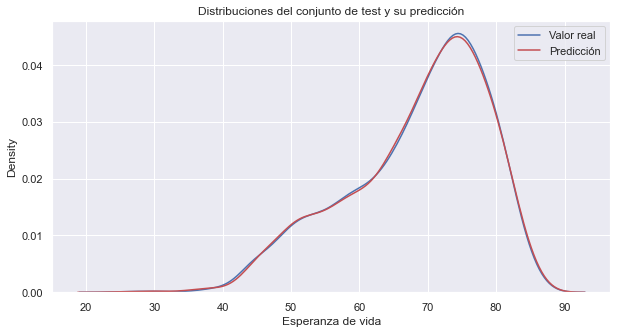

In [163]:
# Distribución de la variable objetivo real y calculada
plt.figure(figsize=(10,5))
sns.distplot(real_vs_predicted['Real Value'], color='b', hist=False, label='Valor real')
sns.distplot(real_vs_predicted['Prediction'], color='r', hist=False, label='Predicción')
plt.legend()
plt.xlabel('Esperanza de vida')
_ = plt.title('Distribuciones del conjunto de test y su predicción')

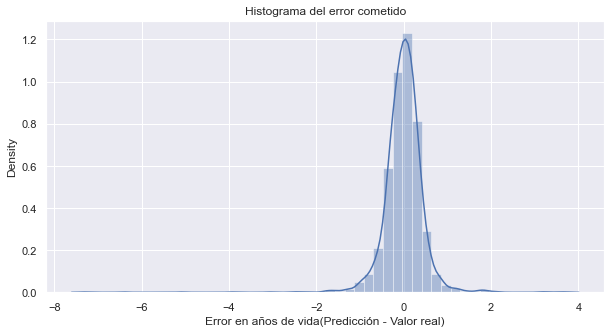

In [127]:
# Distribución del error como la diferencia entre el valor esperado y el obtenido
plt.figure(figsize=(10,5))
sns.distplot(real_vs_predicted['Difference'])
plt.xlabel('Error en años de vida(Predicción - Valor real)')
_ = plt.title('Histograma del error cometido')

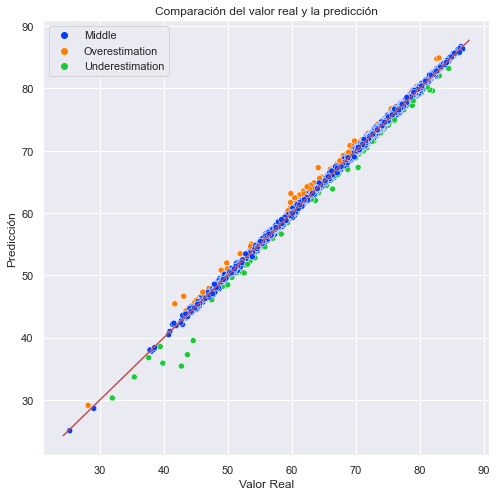

In [136]:
plt.figure(figsize=(8,8))
sns.scatterplot(x='Real Value',y='Prediction', data=real_vs_predicted, hue='Estimation', palette='bright')
plt.plot([y_test_unstandarized.min()-1, y_test_unstandarized.max()+1], [y_test_unstandarized.min()-1, y_test_unstandarized.max()+1], color='r')
plt.xlabel('Valor Real')
plt.ylabel('Predicción')
plt.legend()
_ = plt.title('Comparación del valor real y la predicción')

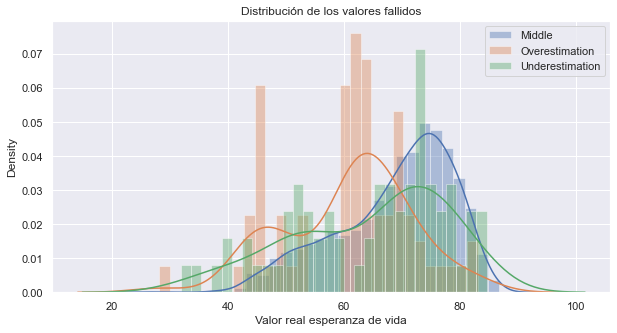

In [137]:
# Distribución del error como la diferencia entre el valor esperado y el obtenido de las predicciones overestimated y underestimated
plt.figure(figsize=(10,5))
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Real Value'], label='Middle')
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Real Value'], label='Overestimation', bins=30)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Real Value'], label='Underestimation', bins=30)
plt.legend()
plt.xlabel('Valor real esperanza de vida')
_ = plt.title('Distribución de los valores fallidos')

In [131]:
#Restamos la media de cada feature para ver aquellas que más se alejan de la media en las predicciones sobreestimadas
abs(real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation'].describe().loc['mean'] - real_vs_predicted.describe().loc['mean']).sort_values(ascending=False).drop(index=['Real Value', 'Prediction', 'Difference']).head()

Life Expectancy                        0.774588
Diet Composition Oils And Fats         0.705614
Low CI Value % Death Cardiovascular    0.649977
Life Expectancy Predicted              0.647287
% Death Cardiovascular                 0.639930
Name: mean, dtype: float64

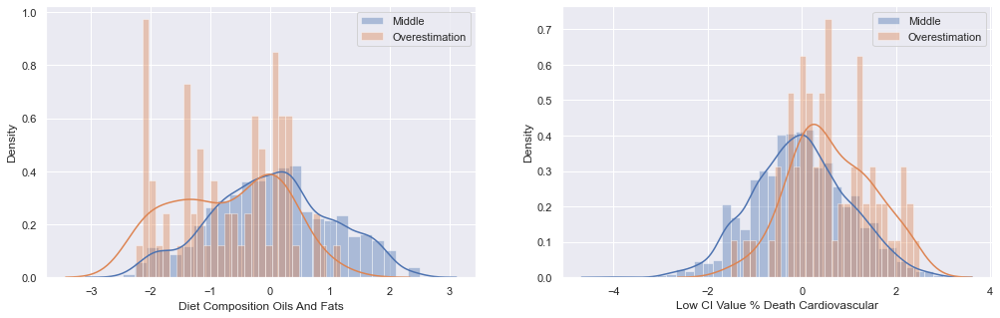

In [138]:
plt.figure(figsize=(17,5))
plt.subplot(1,2,1)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Diet Composition Oils And Fats'], label='Middle')
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Diet Composition Oils And Fats'], label='Overestimation', bins=30)
plt.legend()

plt.subplot(1,2,2)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Low CI Value % Death Cardiovascular'], label='Middle')
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Low CI Value % Death Cardiovascular'], label='Overestimation', bins=30)
plt.legend()

El modelo tiende a sobreestimar cuando el valor a predecir es muy bajo, está en torno a 60-70 o 45-55 años de vida, el valor de Diet Composition Oils And Fats es más bajo de la media y también cuando el valor de (Low CI Value) % Death Cardiovascular es más alto que la media.

In [133]:
#Restamos la media de cada feature para ver aquellas que más se alejan de la media en las predicciones infraestimadas
abs(real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation'].describe().loc['mean'] - real_vs_predicted.describe().loc['mean']).sort_values(ascending=False).drop(index=['Real Value', 'Prediction', 'Difference']).head()

Conflict and Terrorism Deaths %    0.682351
Diet Calories Fat                  0.624516
Diet Composition Oils And Fats     0.606696
Life Expectancy Predicted          0.553234
Basic Hand Washing Total           0.530015
Name: mean, dtype: float64

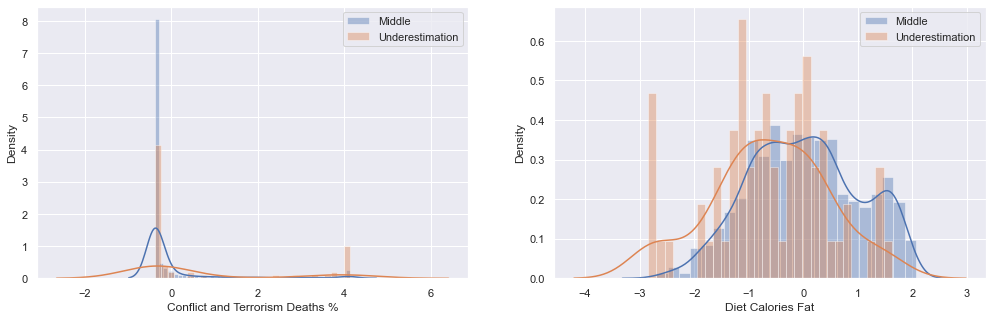

In [139]:
plt.figure(figsize=(17,5))
plt.subplot(1,2,1)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Conflict and Terrorism Deaths %'], label='Middle')

sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Conflict and Terrorism Deaths %'], label='Underestimation', bins=30)
plt.legend()

plt.subplot(1,2,2)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Diet Calories Fat'], label='Middle')
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Diet Calories Fat'], label='Underestimation', bins=30)
plt.legend()

El modelo tiende a infraestimar cuando el valor a predecir es muy bajo, cuando Conflict and Terrorism Deaths % es muy alto y cuando Diet Calories fat es muy bajo.

In [ ]:
# Cómo detectar que una predicción puede estar equivocada??


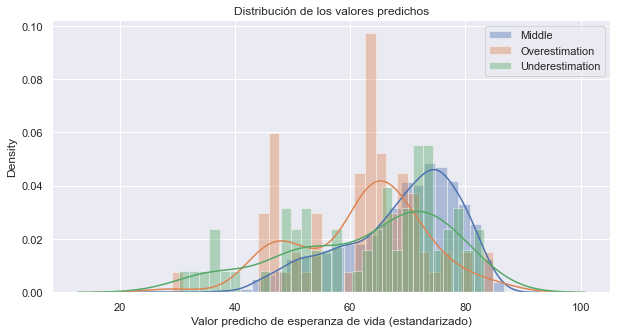

In [142]:
# Distribución del error como la diferencia entre el valor esperado y el obtenido de las predicciones overestimated y underestimated
plt.figure(figsize=(10,5))
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Middle']['Prediction'], label='Middle')
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Overestimation']['Prediction'], label='Overestimation', bins=30)
sns.distplot(real_vs_predicted[real_vs_predicted['Estimation']=='Underestimation']['Prediction'], label='Underestimation', bins=30)
plt.legend()
plt.xlabel('Valor predicho de esperanza de vida en años')
_ = plt.title('Distribución de los valores predichos')

La probabilidad de que el valor predicho tenga un error alto de sobreestimación, será mayor si este está entre 60-65 años, 45-50 o valores muy bajos.

La probabilidad de que el valor predicho tenga un error alto de infraestimación, será mayor si este es un valor bajo(hasta 40años)

Podremos asegurar con más certeza de que el valor predicho es correcto cuando la predicción sea mayor de 70 años.

# Análisis de importancia de features

Wrapper Methods: 
Entrenar varias redes con subconjuntos de entradas para ver cuales son las variables que más influyen.
- Ir añadiendo una a una según la correlación y ver cuánto mejora
- Ir quitando una a una a ver cuánto empeora
- Todas las combianaciones posibles(creo que inviable pero quien sabe)
- Ir probando a mano

## Wrapper Methods

### Backward Feature Selection por correlación con la variable objetivo

In [19]:
# Obtenemos las features según el orden de correlación
corrFeatures = list(abs(df.corr().loc['Life Expectancy']).sort_values(ascending=False).index[1:])

In [20]:
X_trainCorr = X_train[corrFeatures].reset_index(drop=True)
X_testCorr = X_test[corrFeatures].reset_index(drop=True)

In [21]:
#Ejecutamos la red de neuronas con 100 epochs eliminando una a una cada feature
errors = []
for i in range(len(corrFeatures), 0,-1):  
    print(f'Red de neuronas de las {i} features más significativas según la correlación con la variable objetivo:')
    model = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(i,)),
                            layers.Dense(350, activation=tf.nn.relu),
                            layers.Dense(1)])
    model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])
    hist = model.fit(X_trainCorr[corrFeatures[:i]], y_train, epochs=100, verbose=0, validation_split=0.3)

    errors.append(errorsUnstandarized(model.predict(X_testCorr[corrFeatures[:i]]).flatten()))
    print('Error en años:', errors[-1])

Red de neuronas de las 87 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 0.6525525479763941, 'MAE': 0.4932565205573371, 'R2': 0.9959265333374723}
Red de neuronas de las 86 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 0.5451029226894898, 'MAE': 0.35714285038342136, 'R2': 0.9971575675430426}
Red de neuronas de las 85 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 0.5171864056272878, 'MAE': 0.3487323782435705, 'R2': 0.9974412523286401}
Red de neuronas de las 84 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 0.5407161239821497, 'MAE': 0.34859352110754566, 'R2': 0.997203132488429}
Red de neuronas de las 83 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 0.5165453223566622, 'MAE': 0.3487310658815261, 'R2': 0.9974475919693195}
Red de ne

Error en años: {'RMSE': 1.9758116940577963, 'MAE': 1.3043233136128616, 'R2': 0.9626556999354303}
Red de neuronas de las 45 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 1.9334167134443363, 'MAE': 1.2785160815478531, 'R2': 0.9642411020367307}
Red de neuronas de las 44 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 2.0026876775558935, 'MAE': 1.3185726624119176, 'R2': 0.961632839220552}
Red de neuronas de las 43 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 1.9714523233316663, 'MAE': 1.2806425687435528, 'R2': 0.962820307905788}
Red de neuronas de las 42 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 2.0323051637380565, 'MAE': 1.412500882296738, 'R2': 0.9604896355431845}
Red de neuronas de las 41 features más significativas según la correlación con la variable objetivo:
Error en años

Error en años: {'RMSE': 3.9424258024329815, 'MAE': 3.0722771820408146, 'R2': 0.8513173562764541}
Red de neuronas de las 3 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 4.684795074344984, 'MAE': 3.657115962836174, 'R2': 0.7900506988350999}
Red de neuronas de las 2 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 5.219043660575342, 'MAE': 4.067755138718426, 'R2': 0.7394355935139001}
Red de neuronas de las 1 features más significativas según la correlación con la variable objetivo:
Error en años: {'RMSE': 5.679767495859012, 'MAE': 4.409251677001444, 'R2': 0.6914011292511187}


In [22]:
df_errors_wrap_corr = pd.DataFrame(columns = ['RMSE' , 'MAE', 'R2', 'Feature Eliminada'])
df_errors_wrap_corr = df_errors_wrap_corr.append({'RMSE' : errors[0]['RMSE'] , 'MAE' : errors[0]['MAE'], 'R2' : errors[0]['R2'], 'Feature Eliminada': 'Ninguna'} , ignore_index=True)
for i in range(1,len(errors)):
    df_errors_wrap_corr = df_errors_wrap_corr.append({'RMSE' : errors[i]['RMSE'] , 'MAE' : errors[i]['MAE'], 'R2' : errors[i]['R2'], 'Feature Eliminada': corrFeatures[-i]} , ignore_index=True)

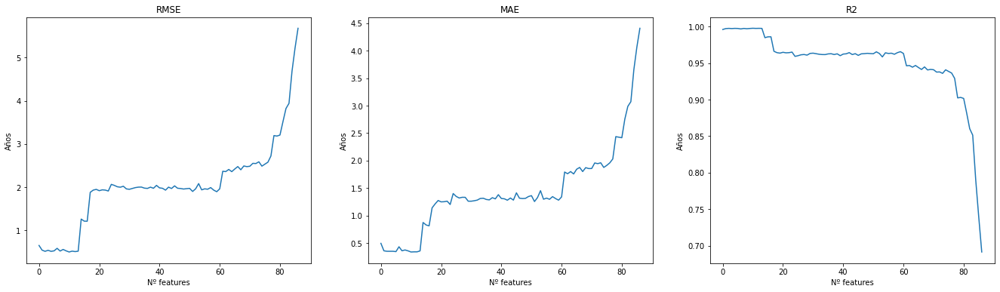

In [23]:
plt.figure(figsize=(23,6))
plt.subplot(1,3,1)
plt.xlabel('Nº features')
plt.ylabel('Años')
plt.title('RMSE')
plt.plot(range(0, len(df_errors_wrap_corr)), df_errors_wrap_corr['RMSE'])

plt.subplot(1,3,2)
plt.xlabel('Nº features')
plt.title('MAE')
plt.ylabel('Años')
plt.plot(range(0, len(df_errors_wrap_corr)), df_errors_wrap_corr['MAE'])

plt.subplot(1,3,3)
plt.xlabel('Nº features')
plt.title('R2')
plt.ylabel('Años')
plt.plot(range(0, len(df_errors_wrap_corr)), df_errors_wrap_corr['R2'])

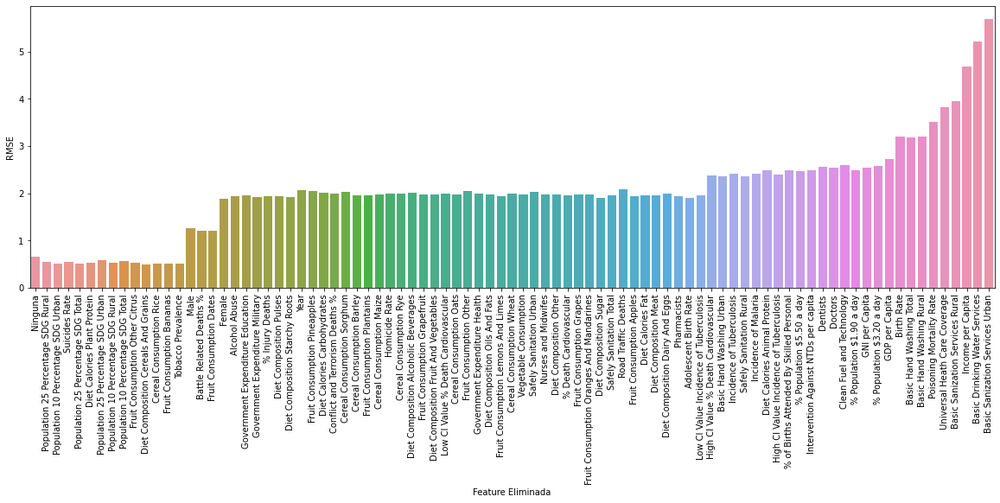

In [24]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Eliminada', y='RMSE', data=df_errors_wrap_corr)
_ = xticks(rotation=90)

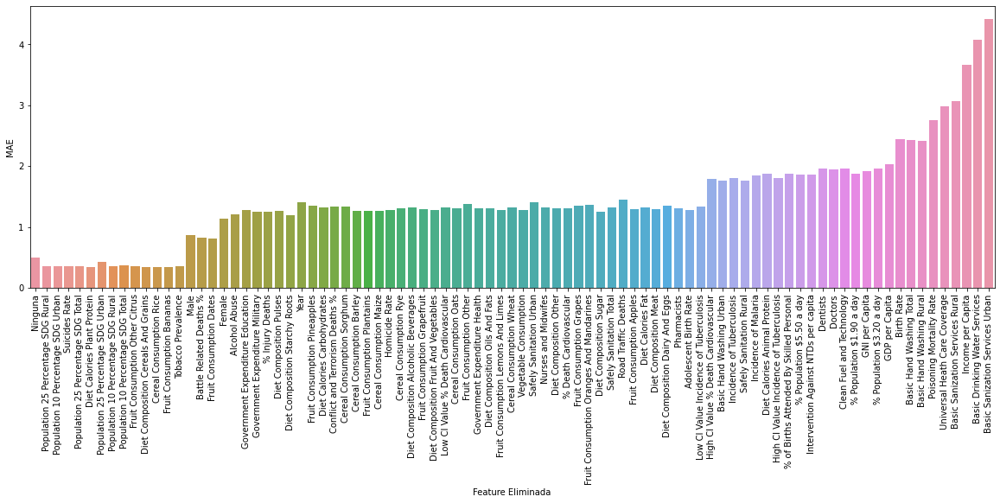

In [25]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Eliminada', y='MAE', data=df_errors_wrap_corr)
_ = xticks(rotation=90)

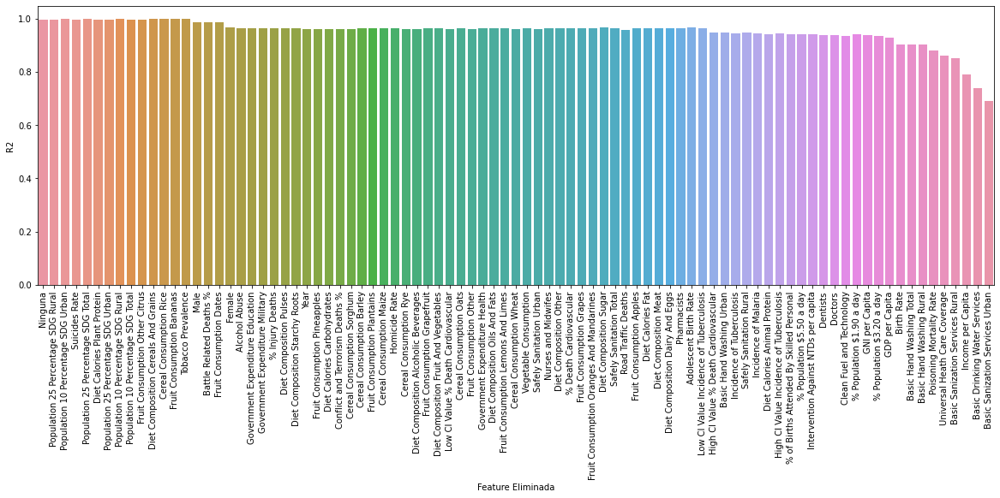

In [26]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Eliminada', y='R2', data=df_errors_wrap_corr)
_ = xticks(rotation=90)

### Forward Feature Selection según los resultados de Random Forrest

In [ ]:
# Orden de importancia de features según los resultados de Random Forest
orderedFeatureImportanceRF = [X.columns[i] for i in np.argsort(rf.feature_importances_)][::-1]

In [ ]:
X_trainRF = X_train[orderedFeatureImportanceRF].reset_index(drop=True)
X_testRF = X_test[orderedFeatureImportanceRF].reset_index(drop=True)

In [ ]:
#Ejecutamos la red con 100 epochs añadiendo una a una cada feature
errors = []
for i in range(2,len(orderedFeatureImportanceRF)):  
    print(f'Red de neuronas de las {i} features más significativas según los resultados de Random Forest:')
    model = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(i,)),
                            layers.Dense(350, activation=tf.nn.relu),
                            layers.Dense(1)])
    model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])
    hist = model.fit(X_trainRF[orderedFeatureImportanceRF[:i]], y_train, epochs=100, verbose=0, validation_split=0.3)

    errors.append(errorsUnstandarized(model.predict(X_testRF[orderedFeatureImportanceRF[:i]]).flatten()))
    print('Error en años:', errors[-1])

Red de neuronas de las 2 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 4.694994787915182, 'MAE': 3.3949679592188318, 'R2': 0.7891355055140244}
Red de neuronas de las 3 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 3.735569135819995, 'MAE': 2.656422586089302, 'R2': 0.8665106007862508}
Red de neuronas de las 4 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 3.251701324414465, 'MAE': 2.3141160702954258, 'R2': 0.898852649740495}
Red de neuronas de las 5 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 2.858652352755144, 'MAE': 2.1130364681660674, 'R2': 0.9218271585772997}
Red de neuronas de las 6 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 2.504811177110985, 'MAE': 1.7583082274541144, 'R2': 0.9399817667729988}
Red de neuronas de las 7 features más significativas según los

In [ ]:
df_errors_wrap_rf = pd.DataFrame(columns = ['RMSE' , 'MAE', 'R2', 'Feature Añadida'])
for i in range(len(errors)):
    df_errors_wrap_rf = df_errors_wrap_rf.append({'RMSE' : errors[i]['RMSE'] , 'MAE' : errors[i]['MAE'], 'R2' : errors[i]['R2'], 'Feature Añadida': orderedFeatureImportanceRF[i+1]} , ignore_index=True)

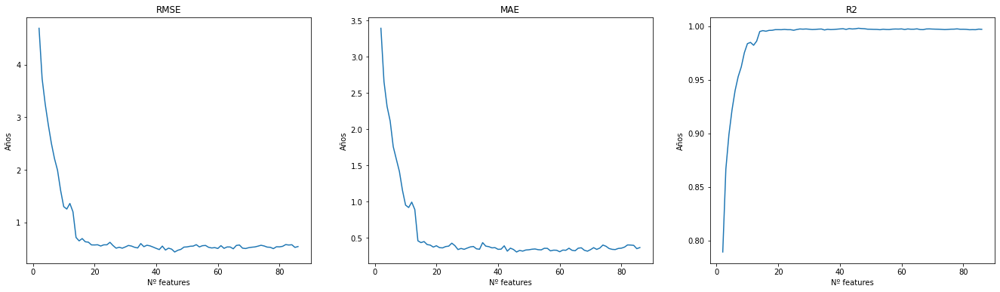

In [ ]:
plt.figure(figsize=(23,6))
plt.subplot(1,3,1)
plt.xlabel('Nº features')
plt.ylabel('Años')
plt.title('RMSE')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors_wrap_rf['RMSE'])

plt.subplot(1,3,2)
plt.xlabel('Nº features')
plt.title('MAE')
plt.ylabel('Años')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors_wrap_rf['MAE'])

plt.subplot(1,3,3)
plt.xlabel('Nº features')
plt.title('R2')
plt.ylabel('Años')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors_wrap_rf['R2'])

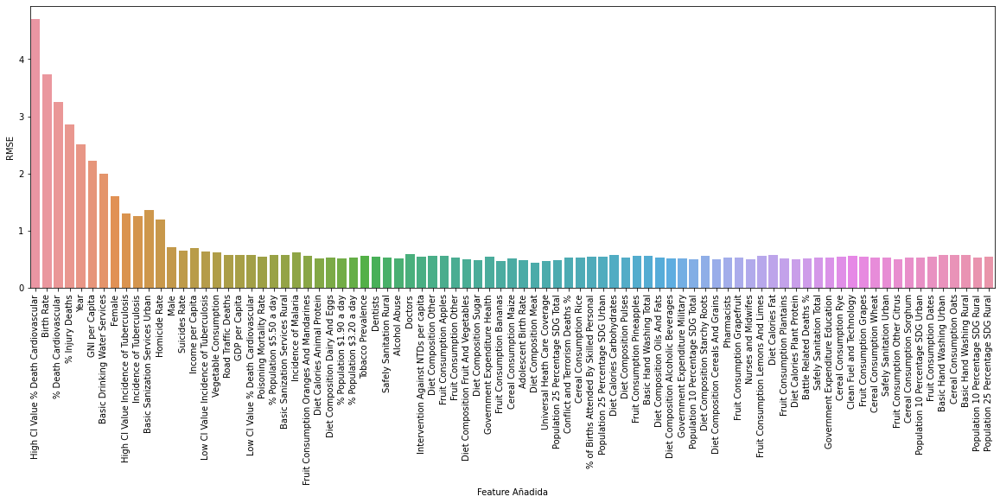

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='RMSE', data=df_errors_wrap_rf)
_ = xticks(rotation=90)

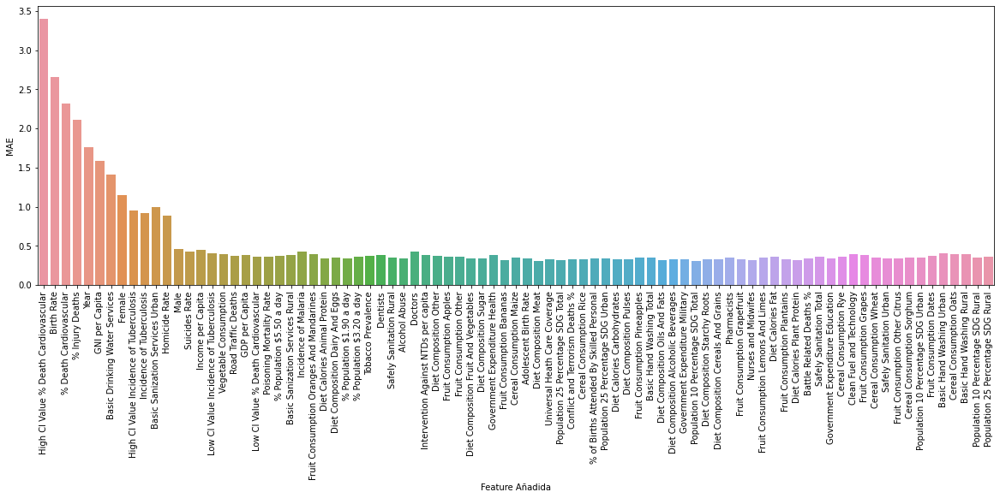

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='MAE', data=df_errors_wrap_rf)
_ = xticks(rotation=90)

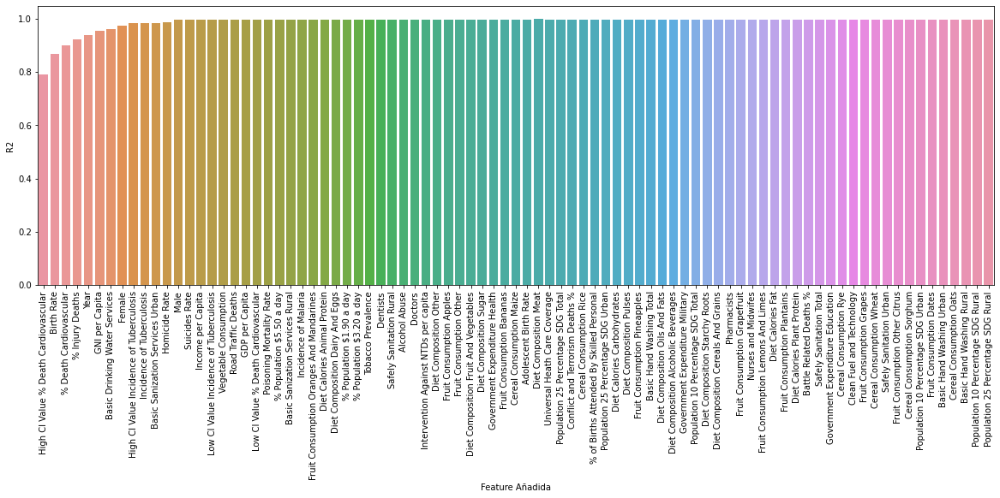

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='R2', data=df_errors_wrap_rf)
_ = xticks(rotation=90)

## Algoritmo Genético

In [152]:
def resultsGenetic(country, year, gender, file_name):
    # Cargamos los resultados de un txt
    file = open(f'Data/GeneticsResults/{file_name}', 'r')
    contents = file.read()
    modifiedValues = np.array(ast.literal_eval(contents))
    
    #Obtenemos los valores originales
    data = getData(country, year, gender)
    originalValues = applyTransformations(data).values.flatten()
    print(f"País: {country}. Año: {year}. Género: {gender}")
    print(f"Esperanza de vida original real: {data['Life Expectancy'].iloc[0]} años.")
    print(f"Esperanza de vida original según el predictor: {format(predictLifeExpectancy(applyTransformations(data)),'.3f')} años.")
    print(f"Esperanza de vida tras los cambios: {format(predictLifeExpectancy(modifiedValues.reshape(1,-1)),'.3f')} años.")
    print(f"Diferencia: {format(predictLifeExpectancy(modifiedValues.reshape(1,-1)) - predictLifeExpectancy(applyTransformations(data)),'.3f')} años.")

    #Mostramos las modificaciones realizadas
    modifications = pd.Series(modifiedValues - originalValues, index=X.columns).sort_values().reset_index().rename({0:'variation'}, axis=1)
    modifications['abs'] = abs(modifications['variation'])
    modifications.sort_values(by='abs', ascending=False, inplace=True)
    plt.figure(figsize=(10,5))
    sns.barplot(x='index', y='variation', data=modifications[:20])
    plt.xlabel('Indicadores con mayor modificación')
    plt.ylabel('Variación (valor estandarizado)')
    _ = xticks(rotation=90)

**Caso 1: España, 2019, Ambos géneros**

Margin_input = 5.0

País: Spain. Año: 2019. Género: Both sexes
Esperanza de vida original real: 83.565 años.
Esperanza de vida original según el predictor: 83.470 años.
Esperanza de vida tras los cambios: 87.101 años.
Diferencia: 3.631 años.


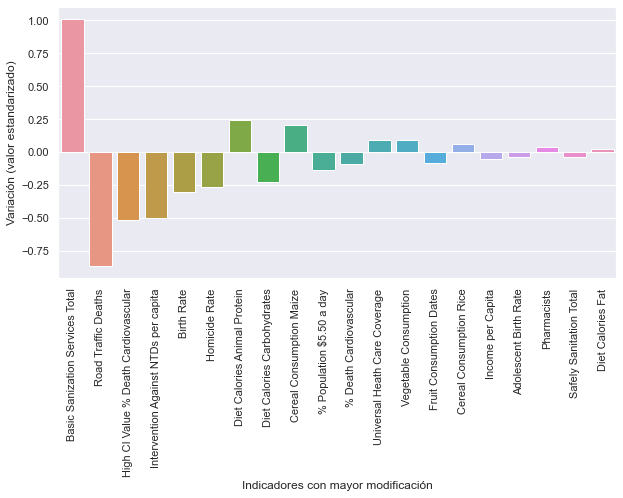

In [153]:
resultsGenetic('Spain', 2019, 'Both sexes', 'Spain2019Both.txt')

**Caso 2: Lituania, 2005, Hombre**

Margin_input = 5.0

Generaciones = 17425

País: Lithuania. Año: 2005. Género: Male
Esperanza de vida original real: 65.764 años.
Esperanza de vida original según el predictor: 65.670 años.
Esperanza de vida tras los cambios: 69.089 años.
Diferencia: 3.419 años.


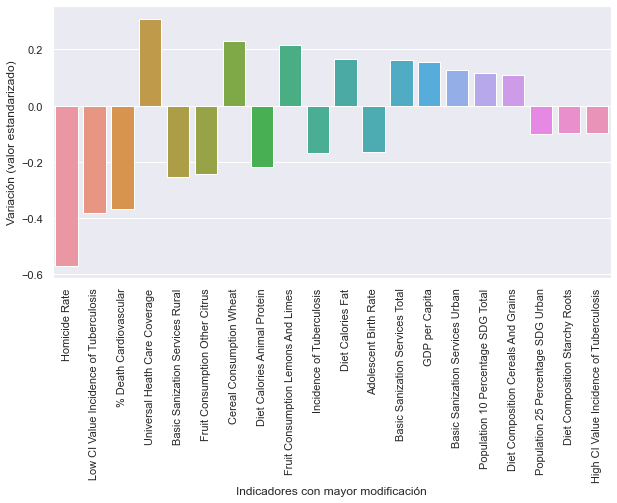

In [154]:
resultsGenetic('Lithuania', 2005, 'Male', 'Lithuania2005Male.txt')

**Caso 3: Afganistán, 1990, ambos géneros**

Margin_input=5.0

Generaciones = 12506

País: Afghanistan. Año: 1990. Género: Both sexes
Esperanza de vida original real: 50.331 años.
Esperanza de vida original según el predictor: 50.319 años.
Esperanza de vida tras los cambios: 54.409 años.
Diferencia: 4.090 años.


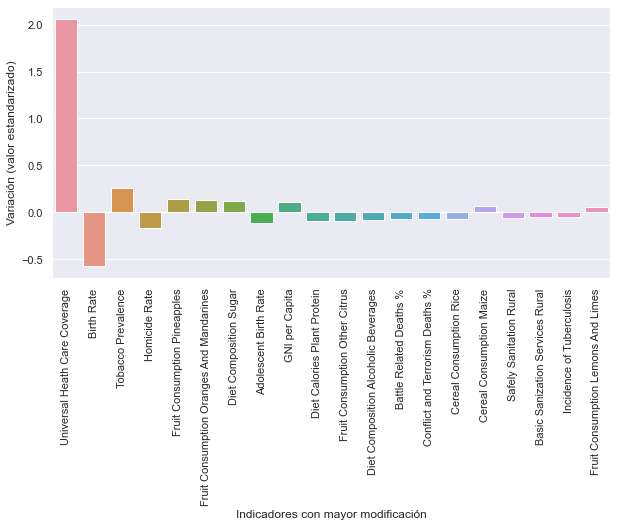

In [143]:
resultsGenetic('Afghanistan', 1990, 'Both sexes', 'Afghanistan1990Both.txt')

## SHAP

In [40]:
explainer = shap.DeepExplainer(NN_model, np.array(X_train))

In [42]:
shap_values = explainer.shap_values(np.array(X_test))

In [39]:
# X_train_sample = shap.sample(X_train, 500, random_state=21)
# X_test_sample = shap.sample(X_test, 500, random_state=21)

In [ ]:
# explainer = shap.KernelExplainer(NN_model.predict, X_train_sample)

In [ ]:
# shap_values = explainer.shap_values(X_test_sample)

In [79]:
# Lo almacenamos en un CSV
np.savetxt('Data/SHAP_values.csv', shap_values[0], delimiter=',')

In [41]:
# Cargamos los shap_values de un CSV
shap_values = []
shap_values.append(np.loadtxt('Data/SHAP_values.csv', delimiter=','))

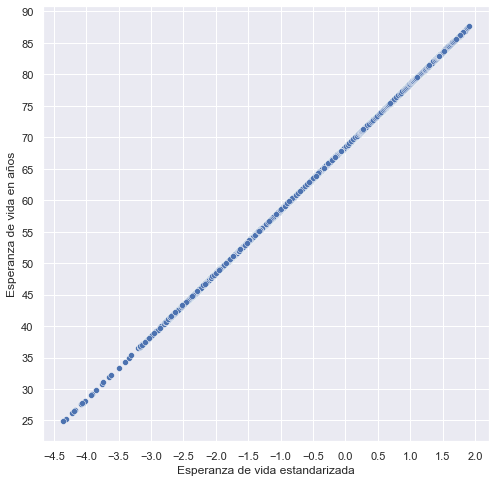

In [57]:
fig,ax = plt.subplots(figsize=(8,8))
sns.scatterplot(df['Life Expectancy'], df_filled['Life Expectancy'])
plt.xlabel('Esperanza de vida estandarizada')
plt.ylabel('Esperanza de vida en años')
ax.yaxis.set_major_locator(matplotlib.ticker.MultipleLocator(5))
ax.xaxis.set_major_locator(matplotlib.ticker.MultipleLocator(0.5))

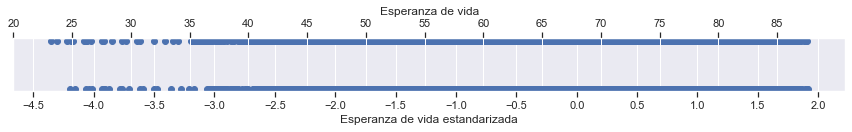

In [41]:
#Conversión de la esperanza de vida
fig, ax1 = plt.subplots(figsize=(12,2))
ax1.set_xlabel('Esperanza de vida estandarizada')
ax1.scatter(df['Life Expectancy'],[0.05]*len(df['Life Expectancy']))
ax1.axes.yaxis.set_visible(False)
ax1.set_xticks(np.arange(-4.5,2.5,0.5))

ax2 = ax1.twiny()  # instantiate a second axes that shares the same x-axis
ax2.scatter(df_filled['Life Expectancy'], [-0.05]*len(df['Life Expectancy']))
ax2.set_xlabel('Esperanza de vida')
ax2.axes.yaxis.set_visible(False)
ax2.set_xticks(np.arange(20,90,5))

fig.tight_layout()  

### Análisis general

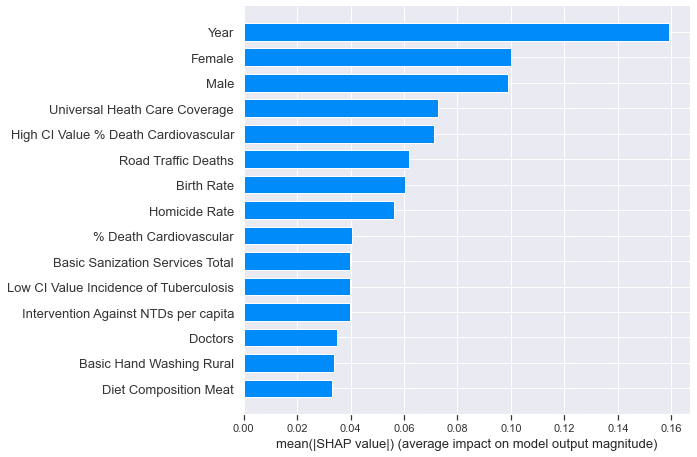

In [16]:
#Features que más afectan al resultado 
shap.summary_plot(shap_values[0], features=X, max_display=15, plot_type="bar")

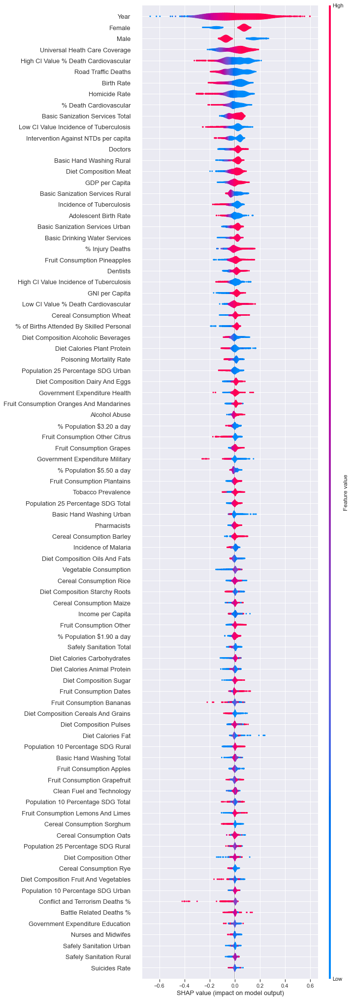

In [19]:
# Valor de la influencia al resultado según el valor de la feature
shap.summary_plot(shap_values[0], features=X_test, max_display=X_test.shape[1], plot_type="violin")

In [150]:
shap.force_plot(explainer.expected_value[0].numpy(), shap_values[0], features=X_test)

### Análisis de influencia de unas features sobre otras

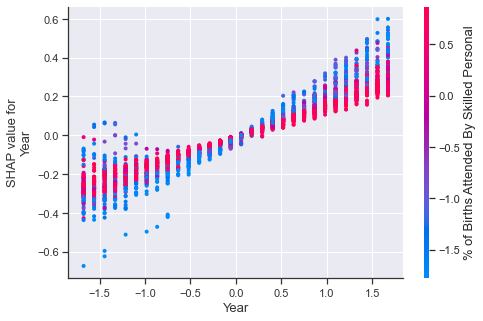

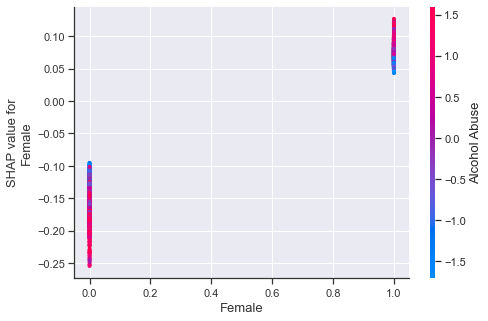

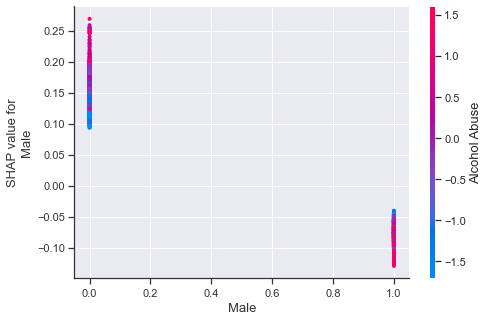

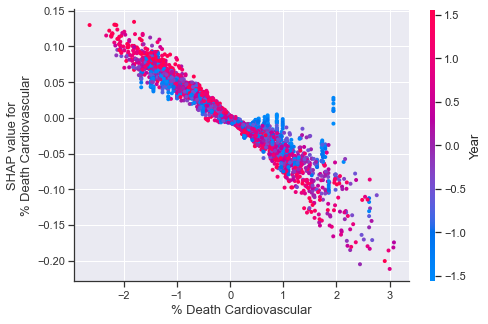

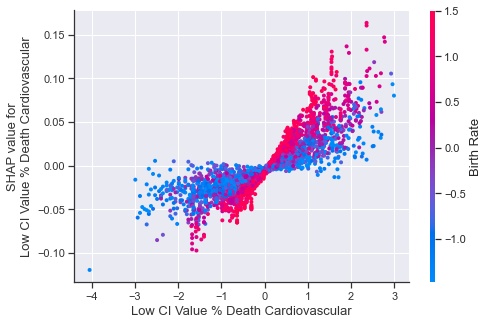

...

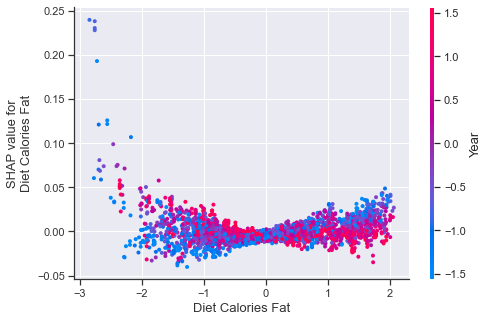

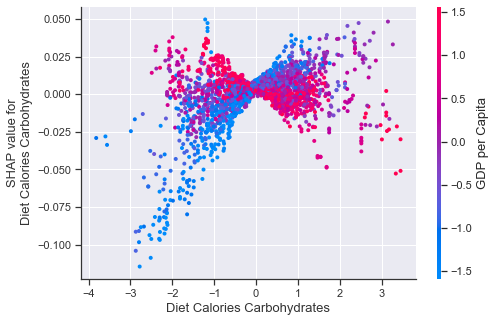

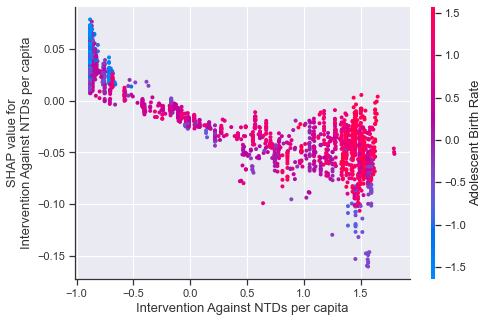

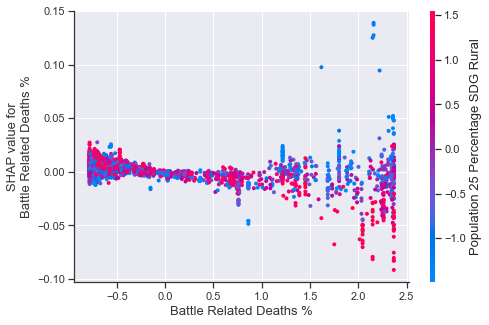

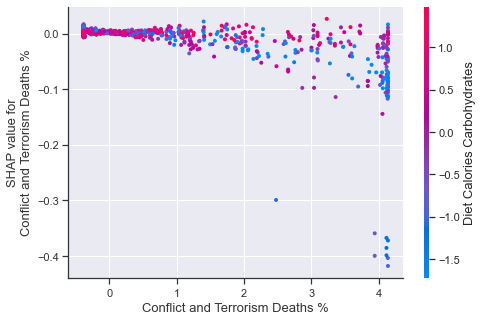

In [20]:
for feature in X.columns:
    shap.dependence_plot(feature, shap_values[0], X_test)

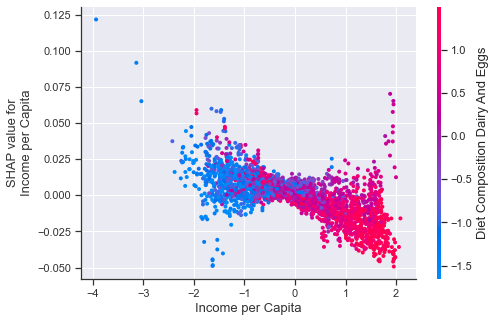

In [24]:
shap.dependence_plot('Income per Capita', shap_values[0], X_test)

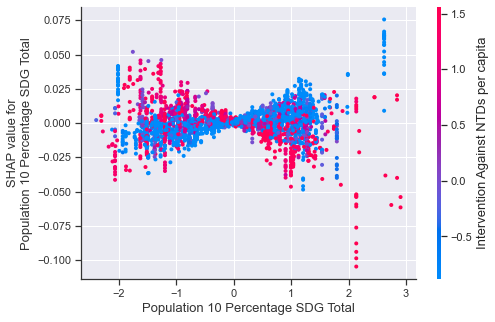

In [26]:
#Depende menos del resto de valores
shap.dependence_plot('Population 10 Percentage SDG Total', shap_values[0], X_test)

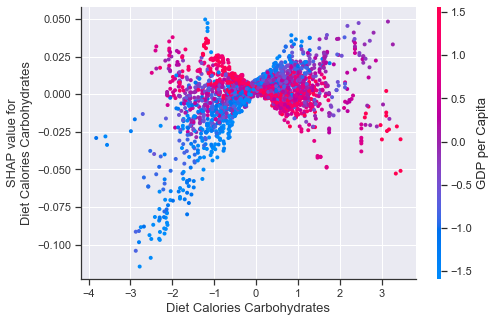

In [25]:
shap.dependence_plot('Diet Calories Carbohydrates', shap_values[0], X_test)

### Casos específicos

In [ ]:
#Hay que tener ejecutado el predictor

In [42]:
data = getData('Spain', 2005, 'Both sexes')
data

,Country,Year,Gender,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
12105,Spain,2005.0,Both sexes,80.553,12.4,10.8,14.2,8.1,12.83,0.23,34.4,99.178693,0.002199,19.0,16.0,22.0,3.9,11.4,82.0,5.094286,5.46,6.02,0.970714,1.08,1.35,27.61,43.25,5.03,8.5,100.0,99.9,99.88,99.99,94.68,94.91,93.93,87.2,87.83,87.06,95.0,10.6,4.0539,26419.296864,0.8,1.1,2.3,22501.110217,25870.0,1.15195,10.77912,3.607965,5.875803,186.0,41.0,290.0,781.0,528.0,286.0,230.0,122.0,43.0,713.0,155.77,0.37,32.97,7.4,0.23,0.28,27.24,15.78,6.58,5.57,0.01,3.8,2.0,5.0,6.938894e-18,0.0,12.0,624.0,70.0,279.2,155.6,1313.55,1471.65,0.000006,0.000001,0.0


In [43]:
case1 = applyTransformations(data)

In [132]:
predictLifeExpectancy(case1)

80.603065

In [44]:
shap_values_case1 = explainer.shap_values(np.array(case1))

In [47]:
shap.force_plot(explainer.expected_value[0].numpy(), shap_values_case1[0][0], feature_names=X.columns)

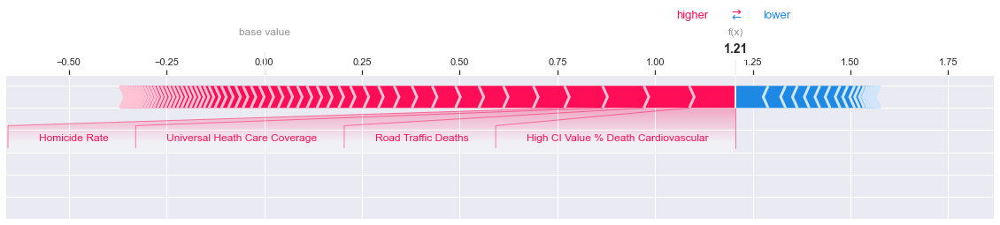

In [58]:
#Esto lo guarda en un fichero
shap.force_plot(explainer.expected_value[0].numpy(), shap_values_case1[0][0], feature_names=X.columns, show=False,matplotlib=True).savefig('scratch.png')

In [137]:
getData('Afghanistan',1990,'Female')

,Country,Year,Gender,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
1,Afghanistan,1990.0,Female,51.442,38.05,23.4,54.05,5.6616,0.21,1.476912,22.636087,28.818393,21.55,189.0,122.0,270.0,15.3,107.968438,35.5,9.735,6.68,10.63,1.04,0.745,1.13,2.015,4.4,0.100787,0.33,37.1,32.28,43.305,28.91,42.110463,81.895,37.31,37.3,63.58,29.02,19.0,48.88,10.44402,500.426925,27.209037,49.05539,74.965386,496.339638,530.0,12.791298,15.063655,6.706276,1.385584,0.0,12.0,35.0,206.0,129.0,113.0,75.0,36.0,19.0,1689.0,37.19,1.261009e-24,19.39,0.03,0.0,0.45,0.94,1.35,0.383221,14.03,0.01955,0.0,1.031689e-21,2.582547e-22,103.0,231.891444,201.0,1195.0,174.0,67.8,197.08,435.6,1613.52,0.407388,0.000119,0.000122


In [48]:
case2 = applyTransformations(getData('Afghanistan',1990,'Female'))
shap_values_case2 = explainer.shap_values(np.array(case2))

In [138]:
predictLifeExpectancy(case2)

51.573566

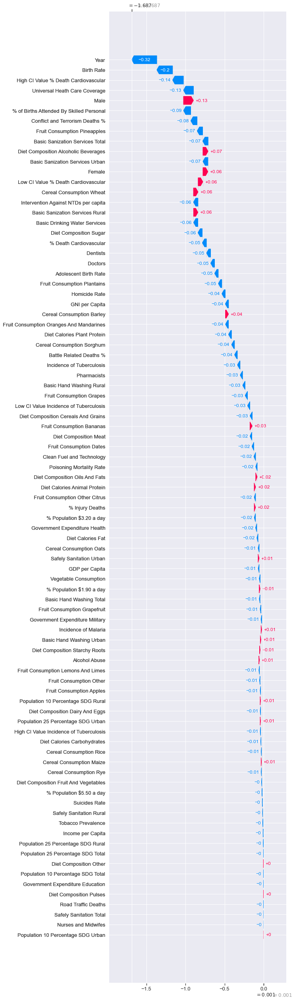

None


In [50]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[0], shap_values_case2[0][0], feature_names=X.columns, max_display=X.shape[1])

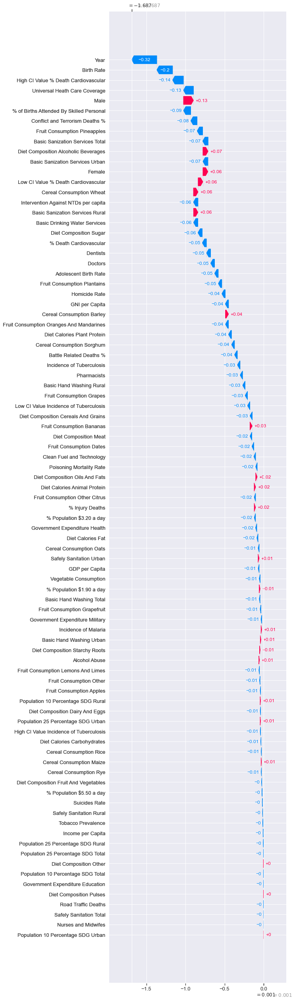

In [63]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[0], shap_values_case2[0][0], feature_names=X.columns, max_display=X.shape[1], show=False)
plt.savefig('scratch.png')

### Comparaciones

In [80]:
def SHAP_comparison(case):
    shap_values_case = explainer.shap_values(np.array(case))
    #Obtenemos el orden para mostrar las features según la desviación típica
    featuresOrder = list(pd.DataFrame(shap_values_case[0], columns=X.columns).describe().loc['std'].reset_index().sort_values(by='std').index)
    shap.decision_plot(explainer.expected_value[0], shap_values_case[0], feature_names=list(X.columns), feature_display_range=slice(None, len(X.columns), 1), feature_order=featuresOrder)

**Comparación evolución año a año**

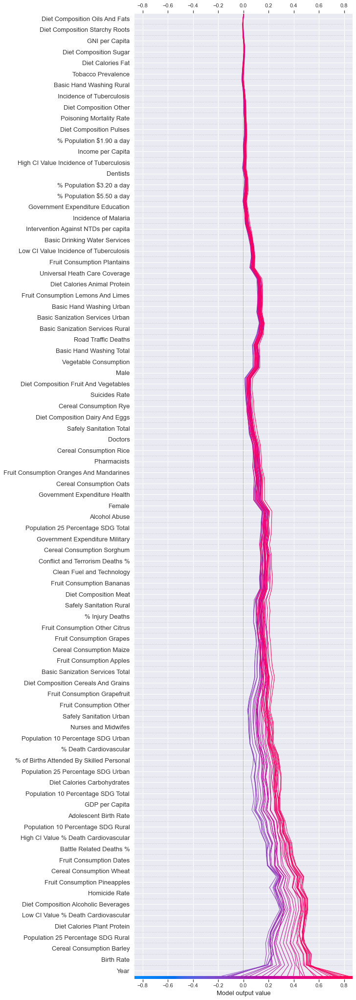

In [81]:
SHAP_comparison(applyTransformations(df_filled[(df_filled['Country']=='Algeria')&(df_filled['Gender']=='Both sexes')]))

In [82]:
shap.force_plot(explainer.expected_value[0].numpy(), explainer.shap_values(np.array(applyTransformations(df_filled[(df_filled['Country']=='Algeria')&(df_filled['Gender']=='Both sexes')])))[0], features=X_test)

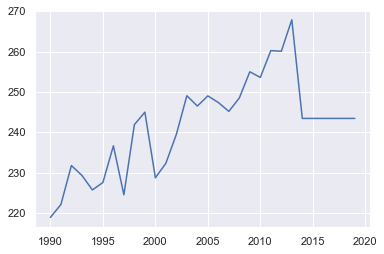

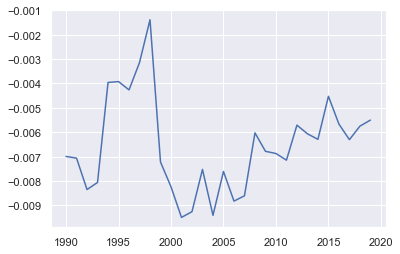

In [83]:
argelia_ev = df_filled[(df_filled['Country']=='Algeria')&(df_filled['Gender']=='Both sexes')]
argelia_shap = explainer.shap_values(np.array(applyTransformations(df_filled[(df_filled['Country']=='Algeria')&(df_filled['Gender']=='Both sexes')])))[0]
plt.figure()
plt.plot(argelia_ev['Year'], argelia_ev['Diet Calories Plant Protein'])
plt.figure()
plt.plot(argelia_ev['Year'], argelia_shap[:,list(argelia_ev.columns).index('Diet Calories Plant Protein')])

**Comparación de países con esperanza de vida alta**

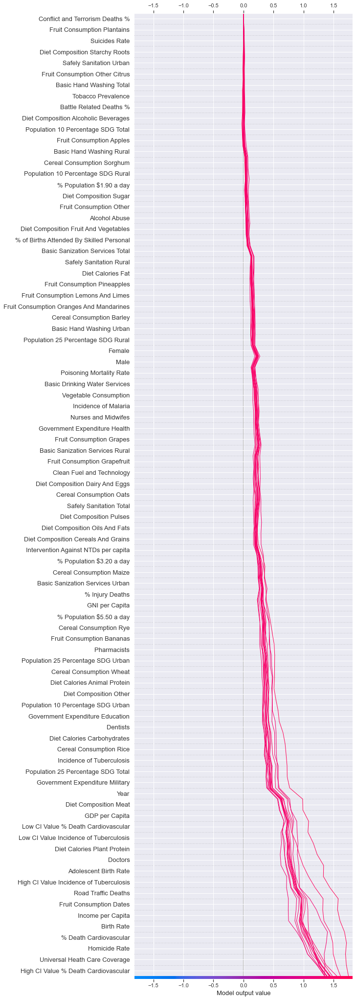

In [84]:
SHAP_comparison(applyTransformations(df_filled[(df_filled['Life Expectancy']> 82.0)&(df_filled['Gender']=='Both sexes')&(df_filled['Year']==2015)]))

**Comparación de países con esperanza de vida media**

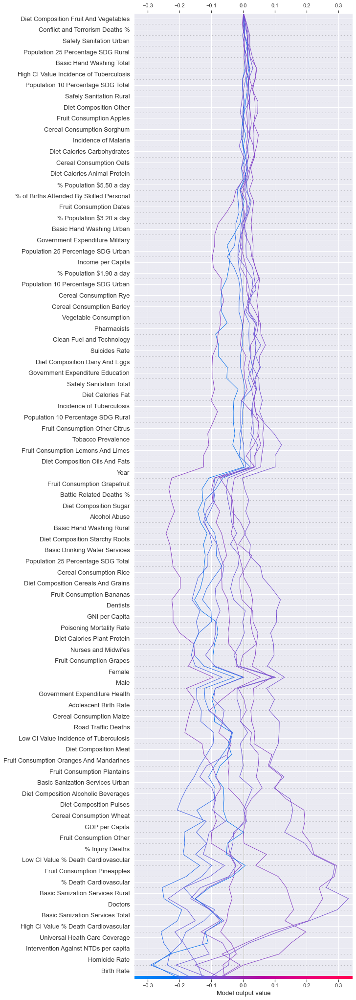

In [85]:
SHAP_comparison(applyTransformations(df_filled[(df_filled['Life Expectancy']> 66.0)&(df_filled['Life Expectancy']< 68.0)&(df_filled['Gender']=='Both sexes')&(df_filled['Year']==2000)]))

**Comparación de países con esperanza de vida media**

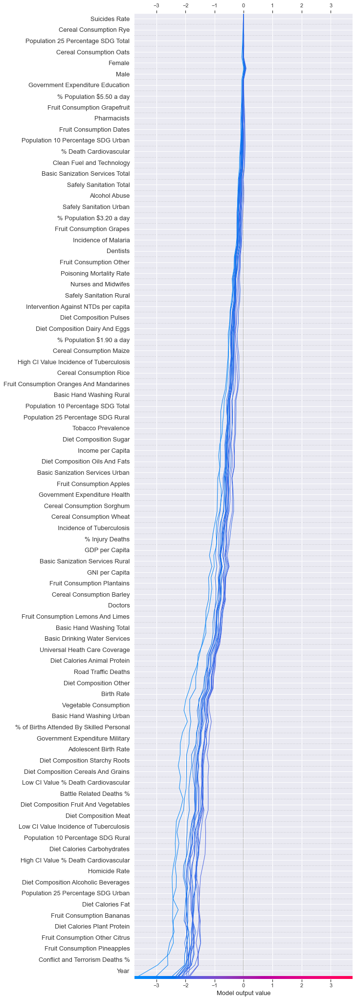

In [86]:
SHAP_comparison(applyTransformations(df_filled[(df_filled['Life Expectancy']< 50.0)&(df_filled['Gender']=='Both sexes')&(df_filled['Year']==1990)]))

In [87]:
shap.decision_plot(explainer.expected_value[0], shap_values[0], feature_names=list(X.columns), feature_display_range=slice(None, len(X.columns), 1))

RuntimeError: Plotting 2874 observations may be slow. Consider subsampling or set ignore_warnings=True to ignore this message.